In [1]:
import scanpy as sc
import pandas as pd

import matplotlib.pyplot as plt

import seaborn as sns

from matplotlib import rcParams

import squidpy as sq

import numpy as np

In [2]:
sc.set_figure_params(dpi_save=300)

In [3]:
# Load global object
#adata = sc.read_h5ad("h5ad/scvi/xenium5k_scVI_CellCharter.h5ad")

adata = sc.read_h5ad("h5ad/scvi/xenium5k_scVI_CellCharter_clustImmune.h5ad")

In [4]:
adata

AnnData object with n_obs × n_vars = 646121 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [5]:
#adata.obs.sample

In [5]:
adata.obs.annot.value_counts()

annot
Enterocyte                    117653
B_plasma_IgA1                  54688
B_memory                       54126
SMC_PPLP2                      45725
Trm/em_CD8                     37432
EC_venous                      30492
SMC_CAPN3                      23440
Treg_IL10                      20185
Tnaive/cm_CD4                  19697
Macrophage                     17878
Trm_CD8                        16973
S3_crypt                       14636
Macrophage_LYVE1               12504
Glial/Enteric_neural_crest     12230
S3_oral_mucosa-like            12090
Goblet                         10811
nan                             8890
S3_lamina propria               7801
Myofibroblast_1                 7654
S4                              7532
Pericyte_1                      7467
Monocyte                        7217
Pericyte_2                      6786
vSMC                            6402
S3x_1                           5907
EC_arterial_2                   5857
TA                              

In [6]:
adata.obs.sample = adata.obs['sample']

In [7]:
adata.obs.sample

0033516_adjacent_aaaalbkb-1    0033516_adjacent
0033516_adjacent_aaaambfn-1    0033516_adjacent
0033516_adjacent_aaabjcij-1    0033516_adjacent
0033516_adjacent_aaacbbae-1    0033516_adjacent
0033516_adjacent_aaacnfcj-1    0033516_adjacent
                                     ...       
0043587_affected_oinhbmma-1    0043587_affected
0043587_affected_oinhjjbb-1    0043587_affected
0043587_affected_oinhkjfn-1    0043587_affected
0043587_affected_oinihmac-1    0043587_affected
0043587_affected_oinjbpdh-1    0043587_affected
Name: sample, Length: 646121, dtype: category
Categories (4, object): ['0033516_adjacent', '0033516_affected', '0043587_adjacent', '0043587_affected']

## Cell and annotation QC

In [8]:
# Cell QC
#adata = adata[adata.obs.total_counts >= 100]
adata = adata[adata.obs.transcript_counts >= 100]

In [9]:
adata

View of AnnData object with n_obs × n_vars = 434516 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', '

In [10]:
# Annotation QC for non-mesenchymal compartments
min_celltypist_confidence = 0.3
adata.obs.loc[
    ~(adata.obs.megagut_lvl1_majority_voting == "Mesenchymal") & (adata.obs.megagut_lvl3_conf_score < min_celltypist_confidence)
    , 'annot'
] = pd.NA

In [11]:
#adata = adata[adata.obs.n_genes_by_counts >=20]

In [12]:
adata

View of AnnData object with n_obs × n_vars = 434516 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', '

## Annotation adjustment and exclusions

In [13]:
#adata.obs.annot.value_counts()

In [14]:
adata.obs.annot = adata.obs.annot.astype(str)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/pandas/core/generic.py:6234: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  self[name] = value


In [15]:
# Recode missing values
adata.obs.loc[adata.obs.annot == 'nan', 'annot'] = pd.NA

In [16]:
# Merge S1 clusters
adata.obs.loc[adata.obs.annot == 'S1_1', 'annot'] = 'S1'
adata.obs.loc[adata.obs.annot == 'S1_2', 'annot'] = 'S1'

In [17]:
# # Exclude annotations for different specified reasons
# adata = adata[~adata.obs.annot.isin([
#     # low count annotations
#     'Mesoderm_2', 'Trm_CD4',
#     # Single sample
#     'B_naive'
#     # Low quality prediction
#     'DC_cDC2', 'Tnaive/cm_CD4'
# ])]

In [18]:
# Set excluded predictions to NA, rather than excluding data points
adata.obs.loc[
    adata.obs.annot.isin([
    # low count annotations
    'Mesoderm_2', 'Trm_CD4',
    # Single sample
    'B_naive',
    # Low quality prediction
    'DC_cDC2', 'Tnaive/cm_CD4', 'Neuroblast', 'Villus fibroblast_F3'
]), 'annot'] = pd.NA

In [19]:
adata.obs.annot = adata.obs.annot.astype('category')

In [20]:
adata

AnnData object with n_obs × n_vars = 434516 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [106]:
# np.sum(adata.obs.annot.isin([
#     # low count annotations
#     'Mesoderm_2', 'Trm_CD4',
#     # Single sample
#     'B_naive',
#     # Low quality prediction
#     'DC_cDC2', 'Tnaive/cm_CD4'
# ]))

In [107]:
# adata.obs.annot.value_counts()

In [21]:
#adata

In [22]:
# Write data for consistent cell and annotation QC
adata.write_h5ad("h5ad/scvi/xenium5k_scVI_CellCharter_clustImmune_postQC.h5ad")

## Global overview plots

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_m

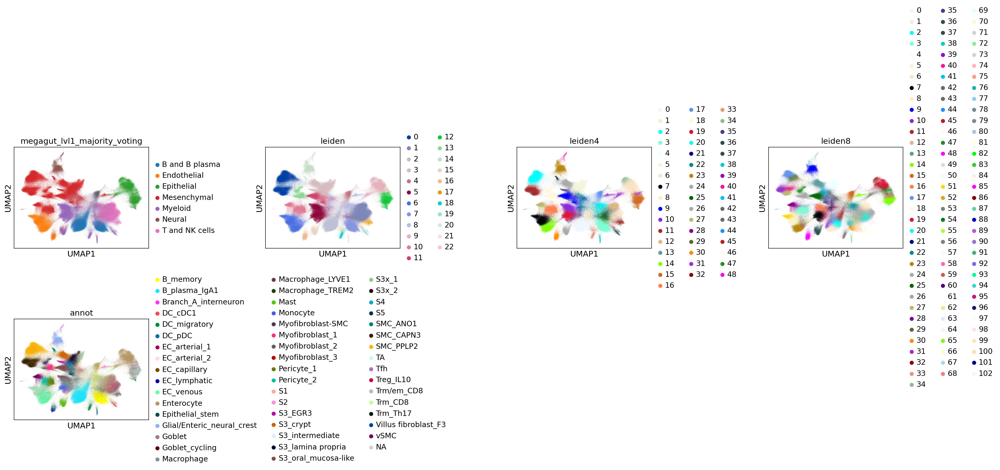

In [24]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata,
    color=[
        "megagut_lvl1_majority_voting", "leiden", "leiden4", "leiden8", "annot"
    ],
    wspace=0.7,
    hspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
#    save="_xenium5k_celltypist_linage_confidence.pdf"
)

## Plots of broad lineages

In [25]:
adata

AnnData object with n_obs × n_vars = 434516 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_m

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


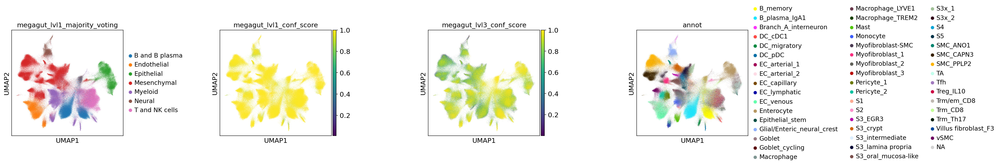

In [26]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata,
    color=[
        "megagut_lvl1_majority_voting", "megagut_lvl1_conf_score", "megagut_lvl3_conf_score", "annot"
    ],
    wspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
    save="_xenium5k_celltypist_linage_confidence.pdf"
)

In [27]:
sc.tl.rank_genes_groups(adata, groupby='megagut_lvl1_majority_voting', method='wilcoxon')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


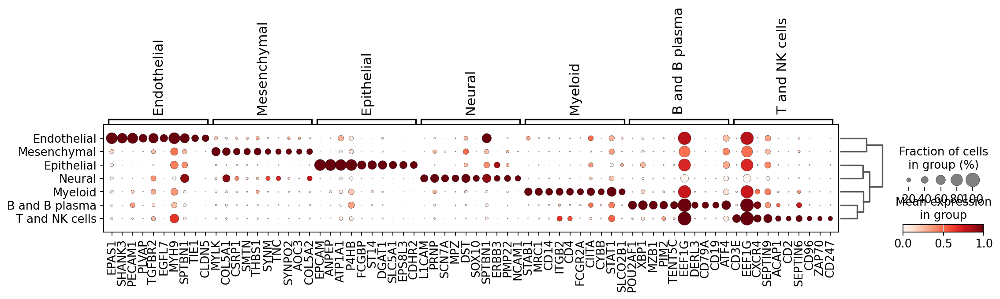

In [28]:
sc.pl.rank_genes_groups_dotplot(
    adata, groupby='megagut_lvl1_majority_voting', standard_scale="var", n_genes=10, title="", figsize=(16, 2.0),
    save="xenium5k_broad_annot_v2.pdf"
)

categories: B and B plasma, Endothelial, Epithelial, etc.
var_group_labels: Endothelial, Mesenchymal, Epithelial, etc.


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **k

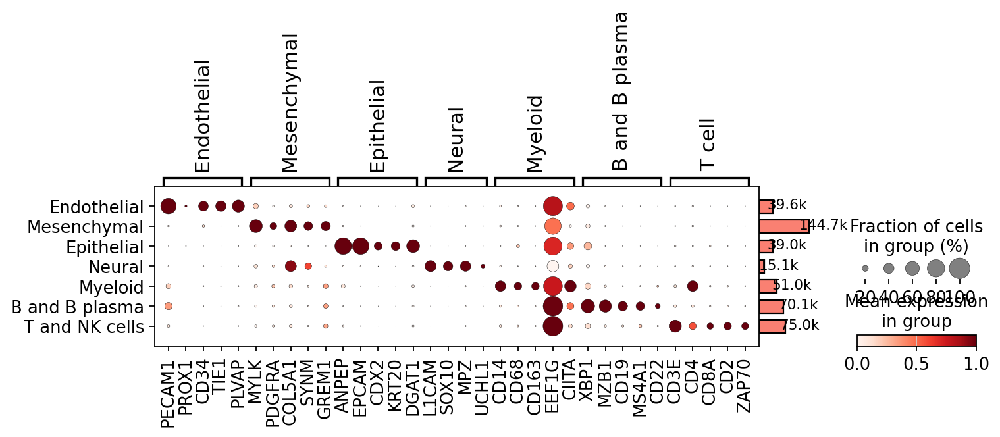

In [29]:
marker_dict = {
    'Endothelial': [
        'PECAM1',
        'PROX1',
        'CD34',
        'TIE1',
        'PLVAP'
    ],
    'Mesenchymal': [
        'MYLK',
        'PDGFRA',
        'COL5A1',
        'SYNM',
        'GREM1'
    ],
    'Epithelial': [
        'ANPEP',
        'EPCAM',
        'CDX2',
        'KRT20',
        'DGAT1'
    ],
    'Neural': [
        'L1CAM',
#        'MCAM1',  # does not exist in Xenium 5k panel
#        'ICAM1',  # did Matthias mean ICAM1 instead?
        'SOX10',
        'MPZ',
        'UCHL1'
    ],
    'Myeloid': [
        'CD14',
        'CD68',
        'CD163',
        'EEF1G',
        'CIITA'
    ],
    'B and B plasma': [
        'XBP1',
        'MZB1',
        'CD19',
        'MS4A1',
        'CD22'
    ],
    'T cell': [
        'CD3E',
        'CD4',
        'CD8A',
        'CD2',
        'ZAP70'
    ]
}

plot = sc.pl.dotplot(
    adata,
    var_names=marker_dict,
    groupby="megagut_lvl1_majority_voting",
    standard_scale='var',
    dendrogram=True,
    figsize=(10, 2),
    show=False,
    return_fig=True
    #save="xenium5k_broad_annot_v3_custom.pdf"
)

plot.add_totals()

#plot.show()

plot.savefig("figures/dotplot_xenium5k_broad_annot_v3_custom.pdf")

## Dotplots of lineage subsets
Other than mesenchymal

In [30]:
adata.obs.megagut_lvl1_majority_voting.value_counts()

megagut_lvl1_majority_voting
Mesenchymal       144689
T and NK cells     74979
B and B plasma     70110
Myeloid            50988
Endothelial        39644
Epithelial         38959
Neural             15147
Name: count, dtype: int64

## T cells

In [31]:
adata_T = adata[adata.obs.megagut_lvl1_majority_voting == 'T and NK cells']


In [32]:
adata_T.obs.annot.value_counts()

annot
Trm/em_CD8       32722
Treg_IL10        11395
Trm_CD8           8663
B_memory          5412
Tfh               4271
Trm_Th17          3660
Enterocyte         979
B_plasma_IgA1      188
Name: count, dtype: int64

In [33]:
# Exclude cells that are not consistent with mesenchymal compartment according to level 3 CellTypist predictions
exclude_cells = ["B_memory", "Enterocyte", "B_plasma_IgA1"]

adata_T = adata_T[~adata_T.obs.annot.isin(exclude_cells)]

In [34]:
adata_T

View of AnnData object with n_obs × n_vars = 68400 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [35]:
sc.tl.rank_genes_groups(adata_T, groupby='annot', method='wilcoxon')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


In [36]:
sc.tl.dendrogram(adata_T, groupby='annot')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


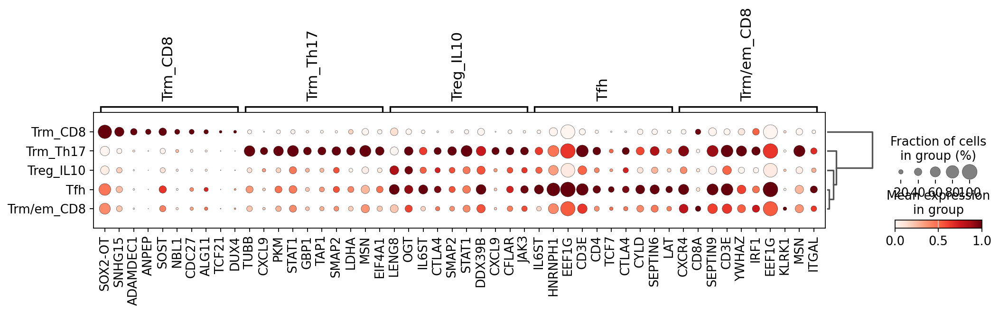

In [37]:
sc.pl.rank_genes_groups_dotplot(
    adata_T, groupby='annot', standard_scale="var", n_genes=10, title="", figsize=(15, 2.0),
    save="xenium5k_annot_Tcells.pdf"
)

In [38]:
sc.pp.neighbors(adata_T, use_rep="X_scVI")

In [39]:
# UMAP
sc.tl.umap(adata_T)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


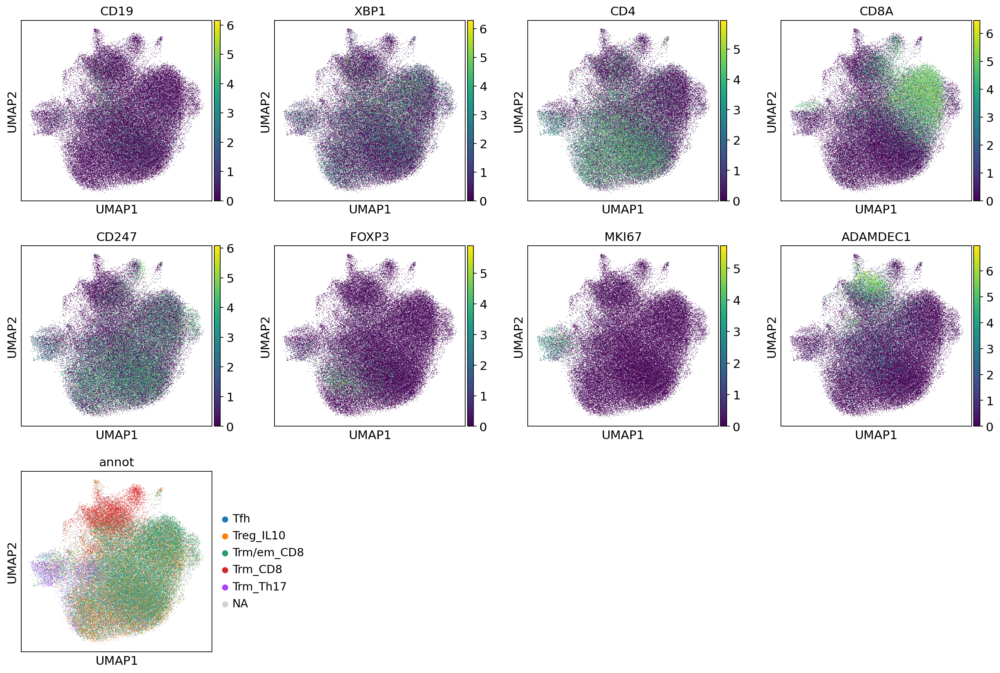

In [40]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_T,
    color=[
        "CD19", "XBP1", "CD4", "CD8A", "CD247", "FOXP3", "MKI67", "ADAMDEC1", "annot"
    ],
    #wspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
#    save="_xenium5k_celltypist_linage_confidence.pdf"
)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_m

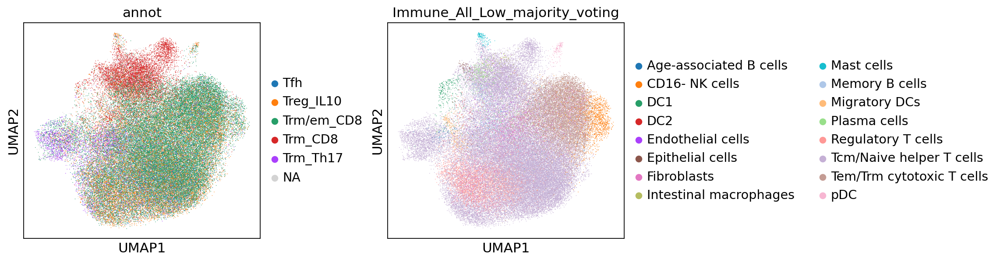

In [41]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_T,
    color=[
        "annot", "Immune_All_Low_majority_voting"
    ],
    wspace=0.4,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
#    save="_xenium5k_celltypist_linage_confidence.pdf"
)

# T and B cells

In [42]:
#adata_B = adata[adata.obs.megagut_lvl1_majority_voting == 'B and B plasma']

adata_BT = adata[adata.obs.megagut_lvl1_majority_voting.isin(['B and B plasma', 'T and NK cells'])]

In [43]:
adata_BT.obs.annot.value_counts()

annot
B_plasma_IgA1    33139
Trm/em_CD8       32722
B_memory         31607
Treg_IL10        11957
Trm_CD8           9170
Tfh               4271
Trm_Th17          3660
Enterocyte        2299
Name: count, dtype: int64

In [44]:
# Exclude cells that are not consistent with mesenchymal compartment according to level 3 CellTypist predictions
exclude_cells = ["Enterocyte"]

adata_BT = adata_BT[~adata_BT.obs.annot.isin(exclude_cells)]

In [45]:
adata_BT.obs.annot.value_counts()

annot
B_plasma_IgA1    33139
Trm/em_CD8       32722
B_memory         31607
Treg_IL10        11957
Trm_CD8           9170
Tfh               4271
Trm_Th17          3660
Name: count, dtype: int64

In [46]:
adata_BT

View of AnnData object with n_obs × n_vars = 142790 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', '

In [47]:
sc.tl.rank_genes_groups(adata_BT, groupby='annot', method='wilcoxon')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


In [48]:
sc.tl.dendrogram(adata_BT, groupby='annot')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **k

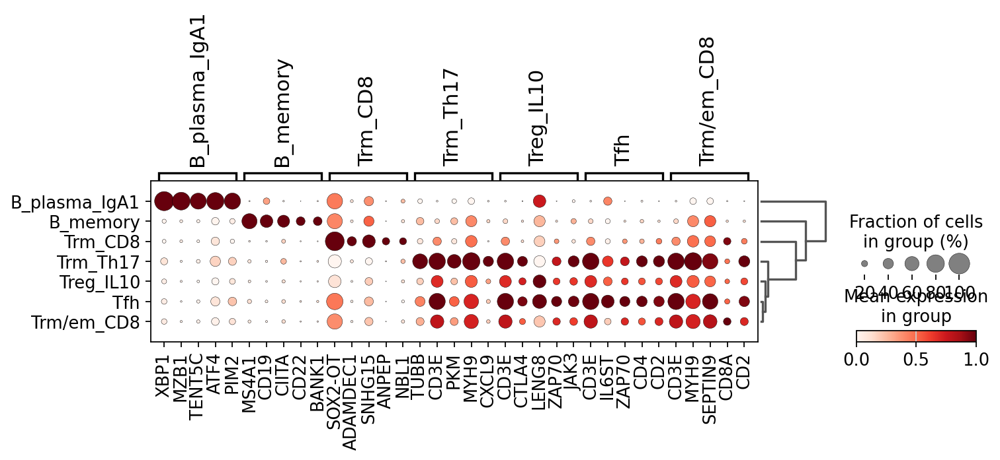

In [49]:
sc.pl.rank_genes_groups_dotplot(
    adata_BT, groupby='annot', standard_scale="var", n_genes=5, title="", figsize=(10, 2.0),
    save="xenium5k_annot_BTcells.pdf"
)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **k

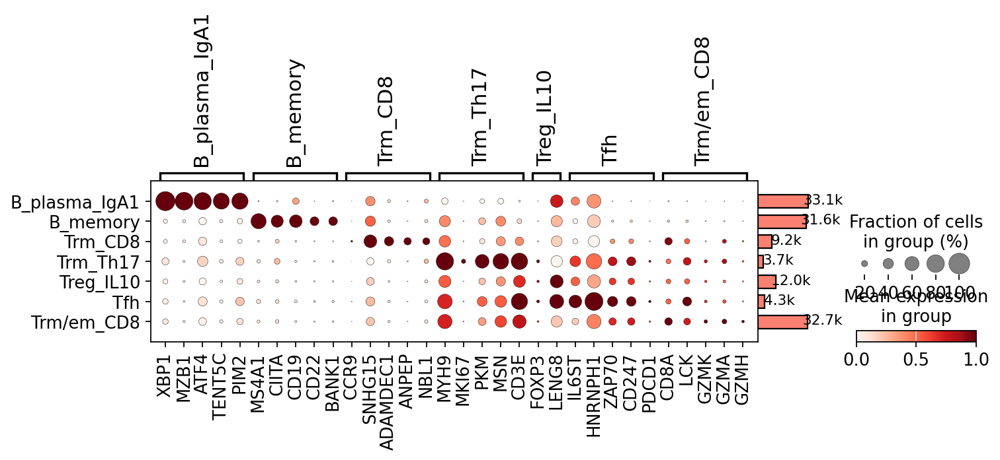

In [50]:
# Custom markers
marker_dict = {
    'B_plasma_IgA1': [
        'XBP1',
        'MZB1',
        'ATF4',
        'TENT5C',
        'PIM2'
    ],
    'Treg_IL10': [
        'FOXP3',
        'LENG8'
    ],
    'Trm_Th17': [
        'MYH9',
        'MKI67',
        'PKM',
        'MSN',
        'CD3E'
    ],
    'Tfh': [
        'IL6ST',
        'HNRNPH1',
        'ZAP70',
        'CD247',
        'PDCD1'
    ],
    'Trm/em_CD8': [
        'CD8A',
        'LCK',
        'GZMK',
        'GZMA',
        'GZMH'
    ],
    'Trm_CD8': [
        'CCR9',
        'SNHG15',
        'ADAMDEC1',
        'ANPEP',
        'NBL1'
    ],
    'B_memory': [
        'MS4A1',
        'CIITA',
        'CD19',
        'CD22',
        'BANK1'
    ]
}

plot = sc.pl.dotplot(
    adata_BT,
    var_names=marker_dict,
    groupby="annot",
    standard_scale='var',
    dendrogram=True,
    figsize=(10, 2),
    show=False,
    return_fig=True
    #save="xenium5k_broad_annot_v3_custom.pdf"
)

plot.add_totals()

#plot.show()

plot.savefig("figures/dotplot_xenium5k_annot_BTcells_v3_custom.pdf")

In [51]:
sc.pp.neighbors(adata_BT, use_rep="X_scVI")

# UMAP
sc.tl.umap(adata_BT)

In [52]:
adata_BT

AnnData object with n_obs × n_vars = 142790 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


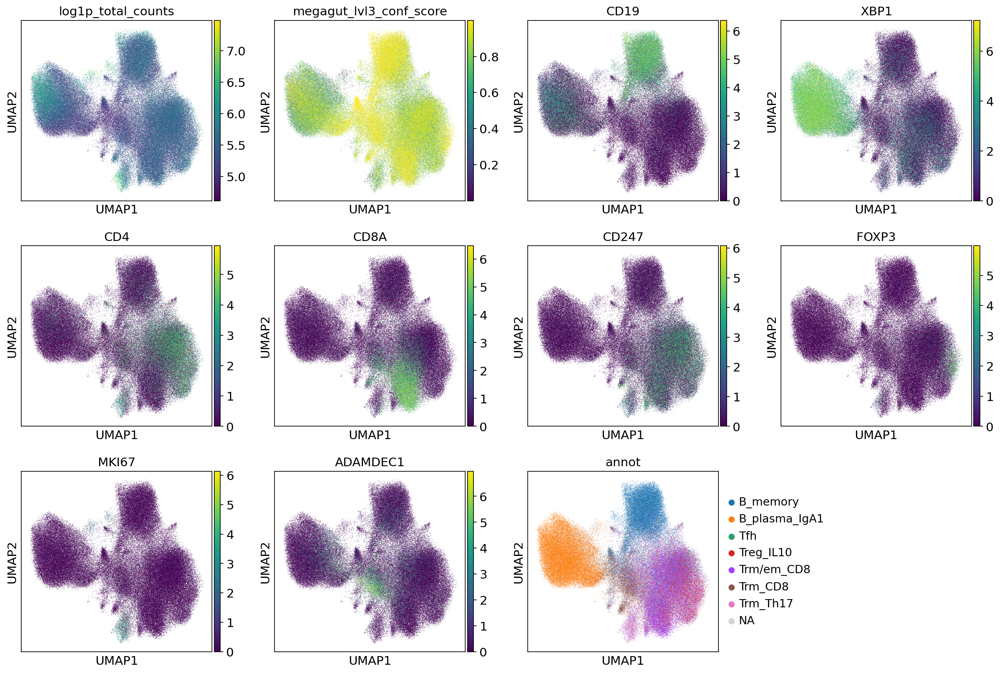

In [53]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_BT,
    color=[
        "log1p_total_counts", "megagut_lvl3_conf_score", "CD19", "XBP1", "CD4", "CD8A", "CD247", "FOXP3", "MKI67", "ADAMDEC1", "annot"
    ],
    #wspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
    save="_xenium5k_BT_markers.pdf"
)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_m

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


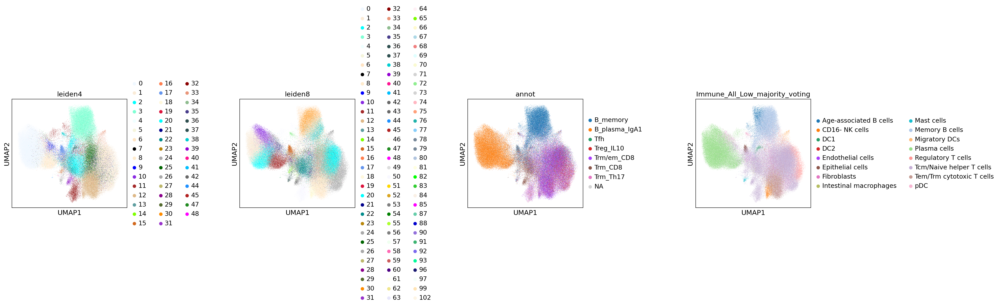

In [54]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_BT,
    color=[
        "leiden4", "leiden8", "annot", "Immune_All_Low_majority_voting"
    ],
    wspace=0.8,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
    save="_xenium5k_BT_cross-tissue_immune.pdf"
)

# Myeloid cells

In [55]:
adata_myeloid = adata[adata.obs.megagut_lvl1_majority_voting.isin(['Myeloid'])]

In [56]:
adata_myeloid

View of AnnData object with n_obs × n_vars = 50988 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [57]:
adata_myeloid.obs.annot.value_counts()

annot
Macrophage          14403
Macrophage_LYVE1    10172
Monocyte             6409
Mast                 4606
DC_cDC1              2659
DC_migratory         2096
DC_pDC                896
Enterocyte            885
B_plasma_IgA1         639
B_memory              593
Goblet                527
Macrophage_TREM2      283
Trm_CD8               270
Trm_Th17               50
Trm/em_CD8             25
Name: count, dtype: int64

In [58]:
exclude_cells = ["Enterocyte", "B_memory", "Tnaive/cm_CD4", "B_plasma_IgA1", "Trm_CD8", "Goblet", "Trm_Th17", "Trm/em_CD8"]

adata_myeloid = adata_myeloid[~adata_myeloid.obs.annot.isin(exclude_cells)]

In [59]:
adata_myeloid

View of AnnData object with n_obs × n_vars = 47999 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [60]:
sc.tl.rank_genes_groups(adata_myeloid, groupby='annot', method='wilcoxon')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


In [61]:
sc.tl.dendrogram(adata_myeloid, groupby='annot')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


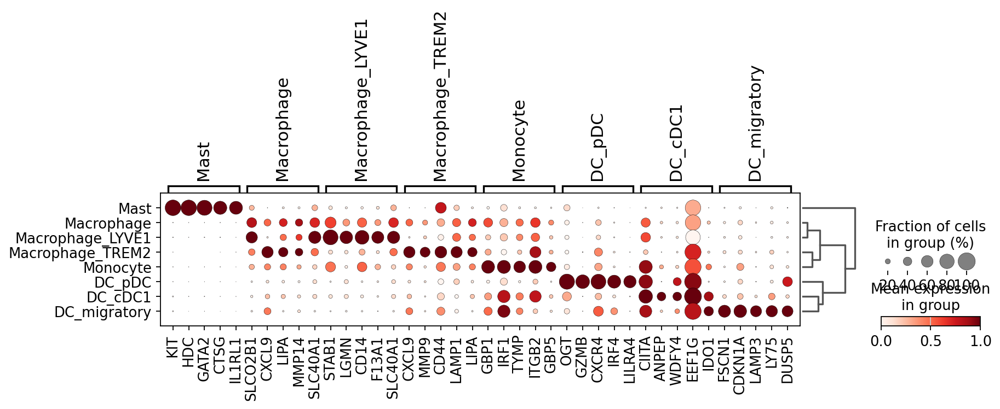

In [62]:
sc.pl.rank_genes_groups_dotplot(
    adata_myeloid, groupby='annot', standard_scale="var", n_genes=5, title="", figsize=(12, 2.0),
    save="xenium5k_annot_myeloid.pdf"
)

In [63]:
sc.pp.neighbors(adata_myeloid, use_rep="X_scVI")

# UMAP
sc.tl.umap(adata_myeloid)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **k

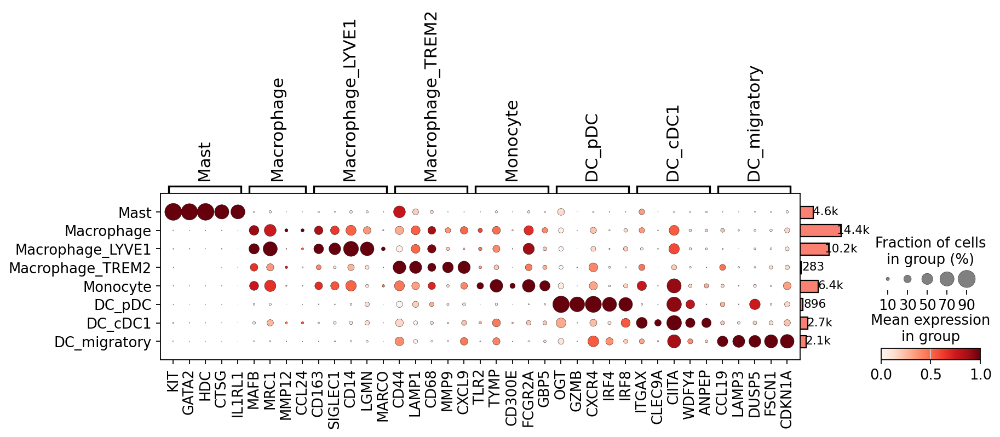

In [105]:
marker_dict = {
    'Mast': [
        'KIT',
        'GATA2',
        'HDC',
        'CTSG',
        'IL1RL1'
    ],
    'Macrophage': [
        'MAFB',
        'MRC1',
        'MMP12',
        'CCL24'
    ],
    'Macrophage_LYVE1': [
        'CD163',
        'SIGLEC1',
        'CD14',
        'LGMN',
        'MARCO'
    ],
    'Macrophage_TREM2': [
        'CD44',
        'LAMP1',
        'CD68',
        'MMP9',
        'CXCL9'
    ],
#     'DC_cDC2': [
#         'CLEC10A',
#         'FCER1A',
#         'CD1D',
#         'CX3CR1'
#     ],
    'Monocyte': [
        'TLR2',
        'TYMP',
        'CD300E',
        'FCGR2A',
        'GBP5'
    ],
    'DC_pDC': [
        'OGT',
        'GZMB',
        'CXCR4',
        'IRF4',
        'IRF8'
    ],
    'DC_cDC1': [
        'ITGAX',
        'CLEC9A',
        'CIITA',
        'WDFY4',
        'ANPEP'
    ],
    'DC_migratory': [
        'CCL19',
        'LAMP3',
        'DUSP5',
        'FSCN1',
        'CDKN1A'
    ]
}

plot = sc.pl.dotplot(
    adata_myeloid,
    var_names=marker_dict,
    groupby="annot",
    standard_scale='var',
    dendrogram=True,
    figsize=(12, 2.5),
    show=False,
    return_fig=True
    #save="xenium5k_broad_annot_v3_custom.pdf"
)

plot.add_totals()

#plot.show()

plot.savefig("figures/dotplot_xenium5k_annot_myeloid_v3_custom.pdf")

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


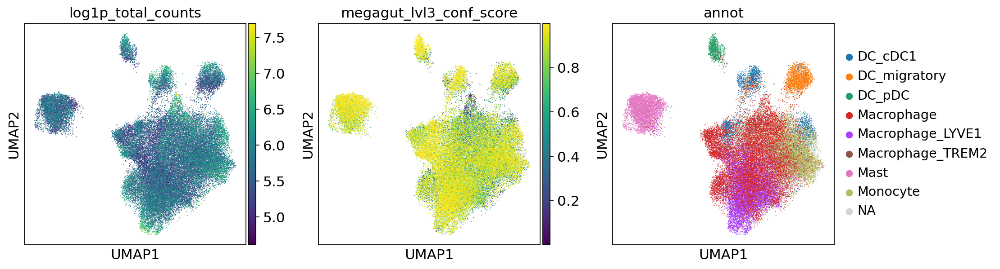

In [65]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_myeloid,
    color=[
        "log1p_total_counts", "megagut_lvl3_conf_score", "annot"
    ],
    #wspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
    save="_xenium5k_myeloid_markers.pdf"
)

## Epithelial cells

In [66]:
adata_epi = adata[adata.obs.megagut_lvl1_majority_voting.isin(['Epithelial'])]

In [67]:
adata_epi

View of AnnData object with n_obs × n_vars = 38959 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [68]:
adata_epi.obs.annot.value_counts()

annot
Enterocyte         22066
Goblet              8340
TA                  4989
Goblet_cycling      1264
Epithelial_stem      900
Treg_IL10             14
B_memory               6
Trm_CD8                5
Name: count, dtype: int64

In [69]:
exclude_cells = ["Tnaive/cm_CD4", "Treg_IL10", "Trm_CD8", "B_memory"]

adata_epi = adata_epi[~adata_epi.obs.annot.isin(exclude_cells)]

In [70]:
adata_epi

View of AnnData object with n_obs × n_vars = 38934 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [71]:
sc.tl.rank_genes_groups(adata_epi, groupby='annot', method='wilcoxon')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


In [72]:
sc.tl.dendrogram(adata_epi, groupby='annot')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


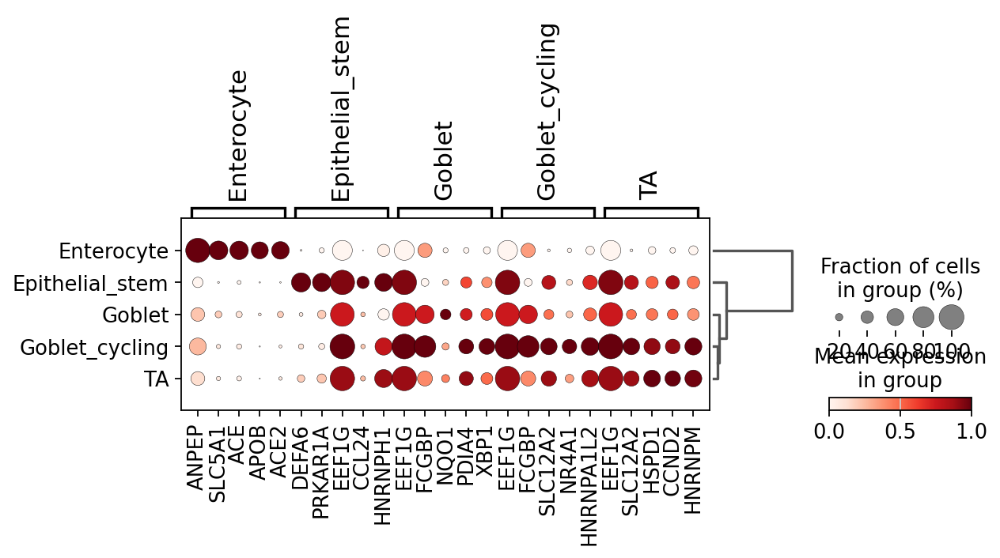

In [73]:
sc.pl.rank_genes_groups_dotplot(
    adata_epi, groupby='annot', standard_scale="var", n_genes=5, title="", figsize=(8, 2.0),
    save="xenium5k_annot_epithelial.pdf"
)

In [74]:
sc.pp.neighbors(adata_epi, use_rep="X_scVI")

# UMAP
sc.tl.umap(adata_epi)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **k

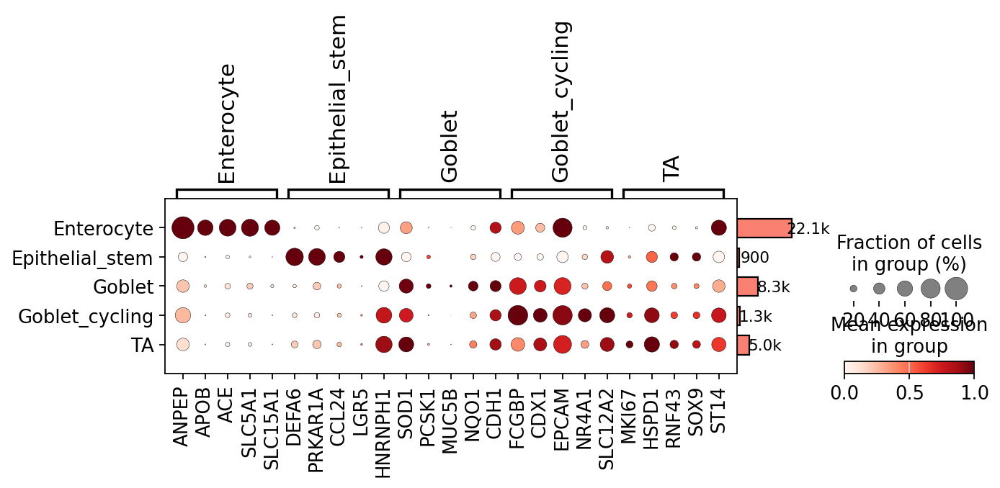

In [75]:
marker_dict = {
    'Enterocyte': [
        'ANPEP',
        'APOB',
        'ACE',
        'SLC5A1',
        'SLC15A1'
    ],
    'Epithelial_stem': [
        'DEFA6',
        'PRKAR1A',
        'CCL24',
        'LGR5',
        'HNRNPH1'
    ],
    'Goblet': [
        'SOD1',
        'PCSK1',
        'MUC5B',
        'NQO1',
        'CDH1'
    ],
    'Goblet_cycling': [
        'FCGBP',
        'CDX1',
        'EPCAM',
        'NR4A1',
        'SLC12A2'
    ],
    'TA': [
        'MKI67',
        'HSPD1',
        'RNF43',
        'SOX9',
        'ST14'
    ]
}

plot = sc.pl.dotplot(
    adata_epi,
    var_names=marker_dict,
    groupby="annot",
    standard_scale='var',
    dendrogram=True,
    figsize=(9, 2.0),
    show=False,
    return_fig=True
    #save="xenium5k_broad_annot_v3_custom.pdf"
)

plot.add_totals()

#plot.show()

plot.savefig("figures/dotplot_xenium5k_annot_epithelial_v3_custom.pdf")

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


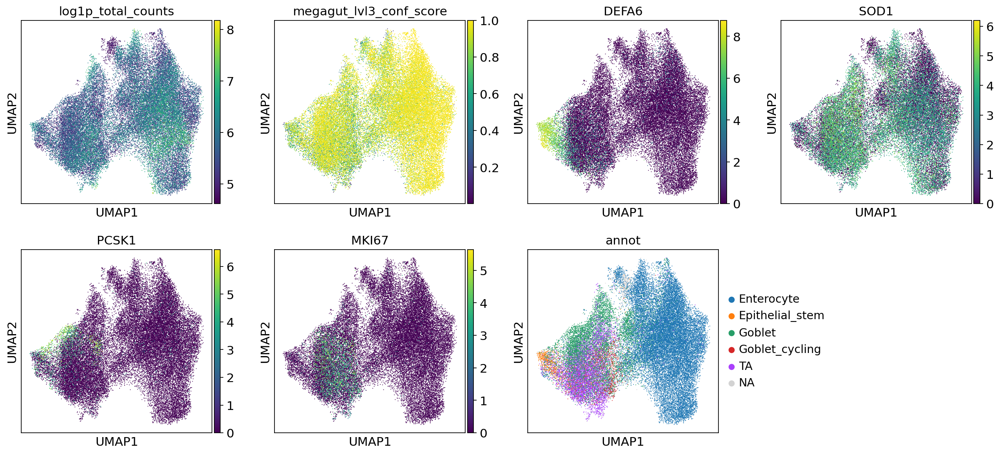

In [76]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_epi,
    color=[
        "log1p_total_counts", "megagut_lvl3_conf_score", "DEFA6", "SOD1", "PCSK1", "MKI67", "annot"
    ],
    #wspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
    save="_xenium5k_epithelial_markers.pdf"
)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_m

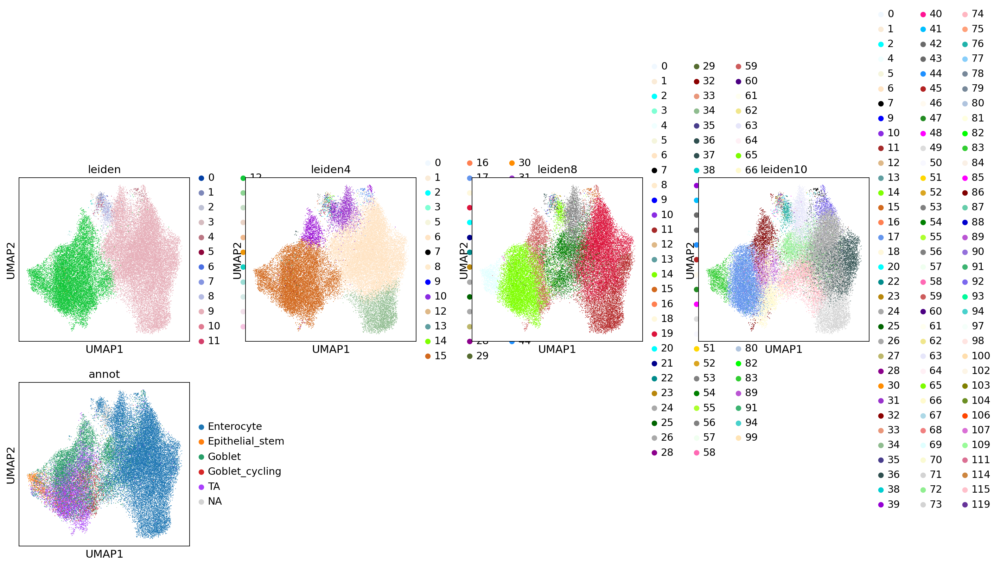

In [77]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_epi,
    color=[
        "leiden", "leiden4", "leiden8", "leiden10", "annot"
    ],
    #wspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
#    save="_xenium5k_epithelial_markers.pdf"
)

In [78]:
adata_epi

AnnData object with n_obs × n_vars = 38934 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob'

In [79]:
#adata_epi.obs.transcript_counts.plot.hist(bins=100)

In [80]:
#adata_epi.obs.megagut_lvl3_conf_score.plot.hist(bins=100)

## Endothelial cells

In [81]:
adata_endo = adata[adata.obs.megagut_lvl1_majority_voting.isin(['Endothelial'])]

In [82]:
adata_endo.obs.annot.value_counts()

annot
EC_venous                     25056
EC_arterial_2                  5306
EC_lymphatic                   3146
EC_arterial_1                  1431
EC_capillary                   1356
Enterocyte                      225
B_memory                        152
Glial/Enteric_neural_crest        8
Name: count, dtype: int64

In [83]:
exclude_cells = ["Enterocyte", "Tnaive", "B_memory", "Glial/Enteric_neural_crest", "Tnaive/cm_CD4"]

adata_endo = adata_endo[~adata_endo.obs.annot.isin(exclude_cells)]

In [84]:
adata_endo

View of AnnData object with n_obs × n_vars = 39259 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [85]:
sc.tl.rank_genes_groups(adata_endo, groupby='annot', method='wilcoxon')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


In [86]:
sc.tl.dendrogram(adata_endo, groupby='annot')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **k

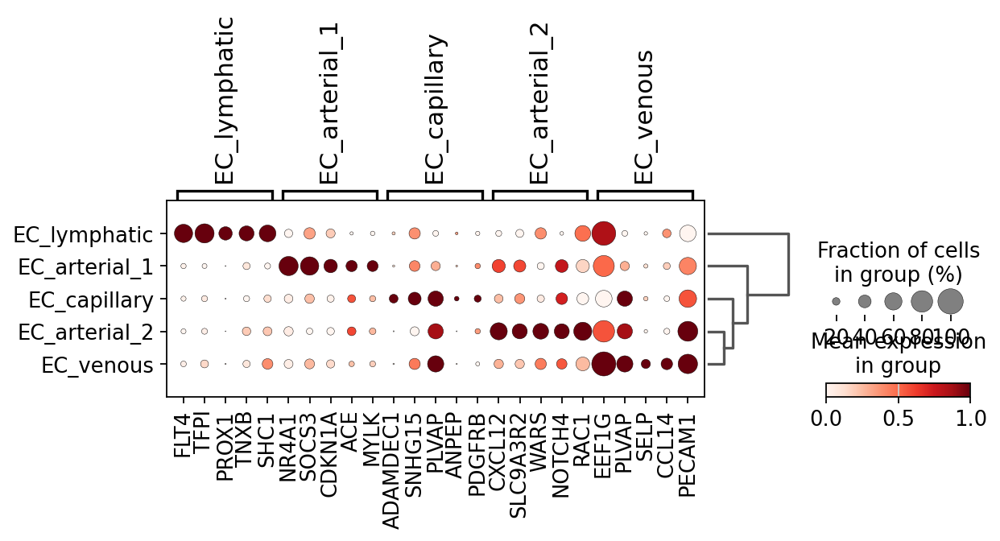

In [87]:
sc.pl.rank_genes_groups_dotplot(
    adata_endo, groupby='annot', standard_scale="var", n_genes=5, title="", figsize=(8, 2.0),
    save="xenium5k_annot_endothelial.pdf"
)

In [88]:
sc.pp.neighbors(adata_endo, use_rep="X_scVI")

# UMAP
sc.tl.umap(adata_endo)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **k

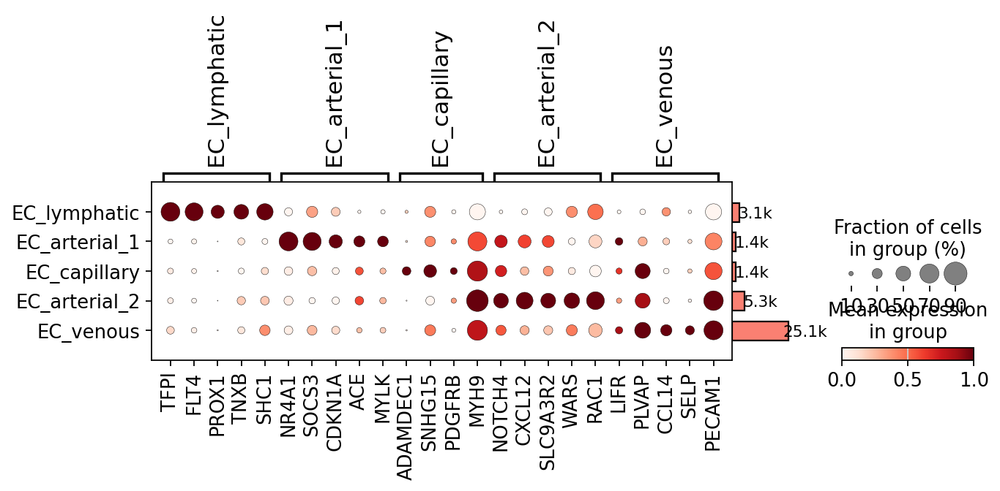

In [89]:
marker_dict = {
    'EC_lymphatic': [
        'TFPI',
        'FLT4',
        'PROX1',
        'TNXB',
        'SHC1'
    ],
    'EC_arterial_1': [
        'NR4A1',
        'SOCS3',
        'CDKN1A',
        'ACE',
        'MYLK'
    ],
    'EC_capillary': [
        'ADAMDEC1',
        'SNHG15',
        'PDGFRB',
        'MYH9'
    ],
    'EC_arterial_2': [
        'NOTCH4',
        'CXCL12',
        'SLC9A3R2',
        'WARS',
        'RAC1'
    ],
    'EC_venous': [
        'LIFR',
        'PLVAP',
        'CCL14',
        'SELP',
        'PECAM1'
    ]
}

plot = sc.pl.dotplot(
    adata_endo,
    var_names=marker_dict,
    groupby="annot",
    standard_scale='var',
    dendrogram=True,
    figsize=(9, 2.0),
    show=False,
    return_fig=True
    #save="xenium5k_broad_annot_v3_custom.pdf"
)

plot.add_totals()

#plot.show()

plot.savefig("figures/dotplot_xenium5k_annot_endothelial_v3_custom.pdf")

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


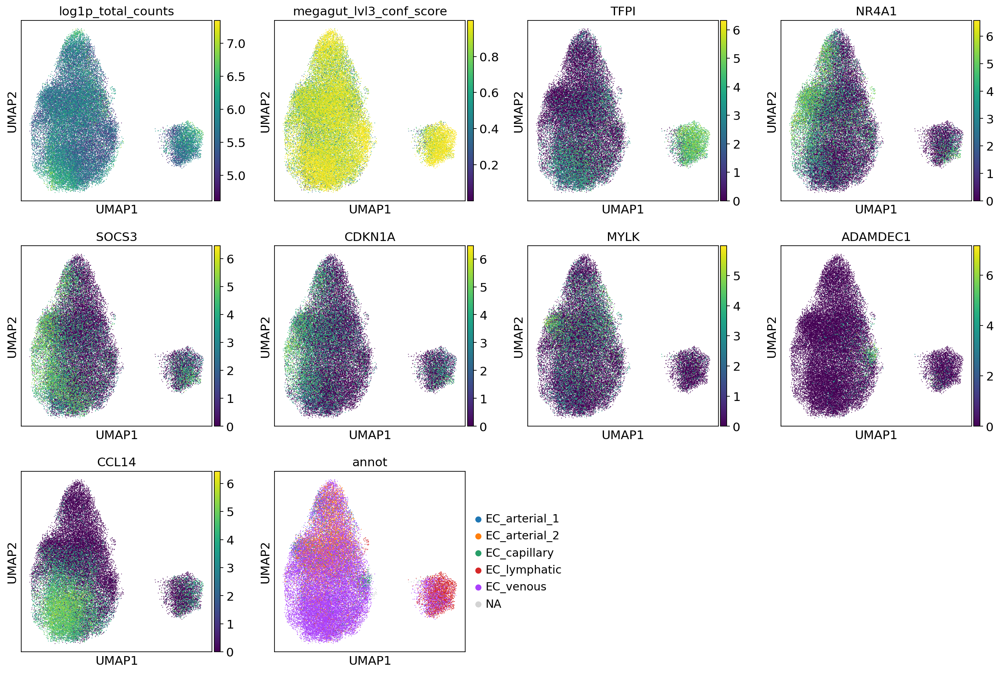

In [90]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_endo,
    color=[
        "log1p_total_counts", "megagut_lvl3_conf_score", "TFPI", "NR4A1", "SOCS3", "CDKN1A", "MYLK", "ADAMDEC1", "CCL14", "annot"
    ],
    #wspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
    save="_xenium5k_endothelial_markers.pdf"
)

## Neural

In [91]:
#adata_neuro = adata[adata.obs.megagut_lvl1_majority_voting.isin(['Neural'])]

adata_neuro = adata[adata.obs.megagut_lvl1_majority_voting.isin(['Neural']) | (adata.obs.annot == 'SMC_ANO1')]

In [92]:
adata_neuro

View of AnnData object with n_obs × n_vars = 16452 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [93]:
adata_neuro.obs.annot.value_counts()

annot
Glial/Enteric_neural_crest    8783
Enterocyte                    3076
SMC_ANO1                      1305
Trm_CD8                        657
Branch_A_interneuron           320
Treg_IL10                       99
B_memory                        50
Name: count, dtype: int64

In [94]:
exclude_cells = ["Enterocyte", "Trm_CD8", "Tnaive/cm_CD4", "Treg_IL10", "B_memory"]

adata_neuro = adata_neuro[~adata_neuro.obs.annot.isin(exclude_cells)]

In [95]:
adata_neuro

View of AnnData object with n_obs × n_vars = 12570 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S

In [96]:
sc.tl.rank_genes_groups(adata_neuro, groupby='annot', method='wilcoxon')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


In [97]:
sc.tl.dendrogram(adata_neuro, groupby='annot')

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **k

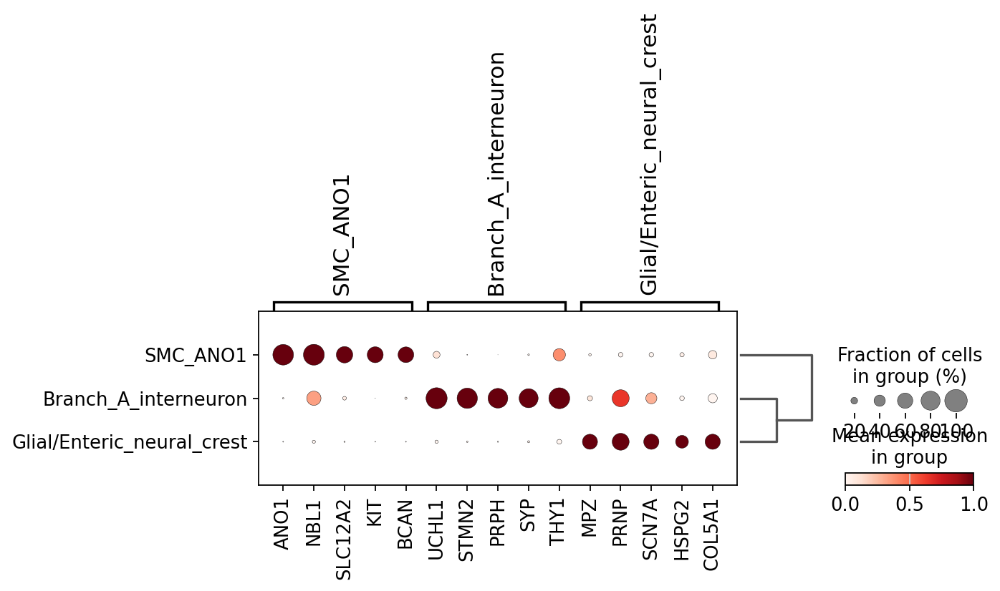

In [98]:
sc.pl.rank_genes_groups_dotplot(
    adata_neuro, groupby='annot', standard_scale="var", n_genes=5, title="", figsize=(8, 2.0),
    save="xenium5k_annot_neural.pdf"
)

In [99]:
sc.pp.neighbors(adata_neuro, use_rep="X_scVI")

# UMAP
sc.tl.umap(adata_neuro)

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **k

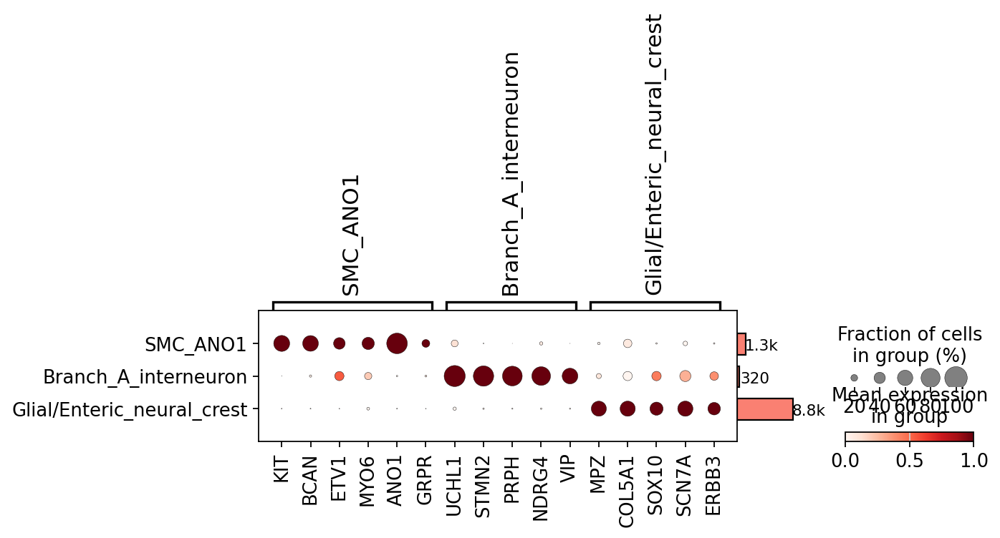

In [103]:
marker_dict = {
#     'Neuroblast': [
#         'SOST',
#         'ALG11',
#         'DUX4'
#     ],
    'Branch_A_interneuron': [
        'UCHL1',
        'STMN2',
        'PRPH',
        'NDRG4',
        'VIP'
    ],
    'Glial/Enteric_neural_crest': [
        'MPZ',
        'COL5A1',
        'SOX10',
        'SCN7A',
        'ERBB3'
    ],
    'SMC_ANO1': [
        'KIT',
        'BCAN',
        'ETV1',
        'MYO6',
        'ANO1',
        'GRPR'
    ]
}

plot = sc.pl.dotplot(
    adata_neuro,
    var_names=marker_dict,
    groupby="annot",
    standard_scale='var',
    dendrogram=True,
    figsize=(8, 1.5),
    show=False,
    return_fig=True
    #save="xenium5k_broad_annot_v3_custom.pdf"
)

plot.add_totals()

#plot.show()

plot.savefig("figures/dotplot_xenium5k_annot_neural_v3_custom.pdf")

In [101]:
adata_neuro

AnnData object with n_obs × n_vars = 12570 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob'

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_m

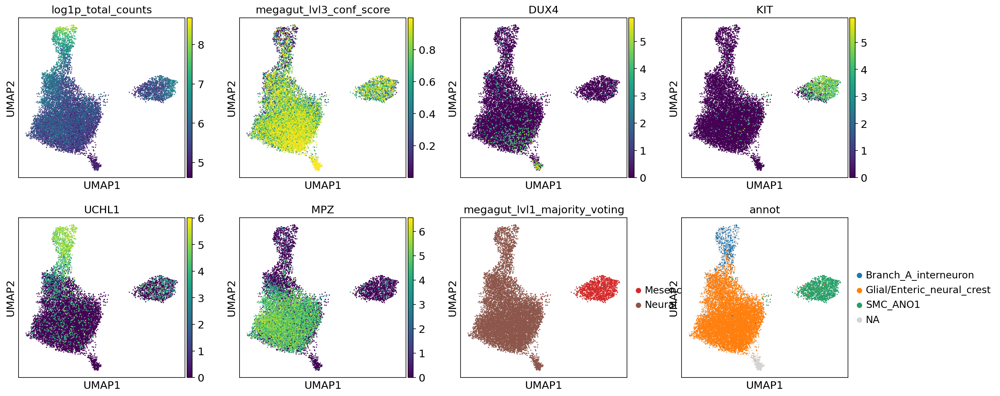

In [102]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_neuro,
    color=[
        "log1p_total_counts", "megagut_lvl3_conf_score", "DUX4", "KIT", "UCHL1", "MPZ", "megagut_lvl1_majority_voting", "annot"
    ],
    #wspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
    save="_xenium5k_neural_markers.pdf"
)